In [1]:
import os, re
import numpy as np
import pandas as pd
from IPython.display import display
import warnings
warnings.filterwarnings("ignore") 

import scipy.sparse as sparse
from scipy.io import mmread
from scipy.stats import pearsonr, pointbiserialr

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.lines import Line2D

import seaborn as sns
import scanpy as sc
sc.logging.print_header()
sc.set_figure_params(facecolor="white", figsize=(8, 8))
sc.settings.verbosity = 1 # errors (0), warnings (1), info (2), hints (3)
plt.rcParams["font.family"] = "Arial"
sns.set_style("white")

import random
# Note that BANKSY itself is deterministic, here the seeds affect the umap clusters and leiden partition
seed = 1234
np.random.seed(seed)
random.seed(seed)

scanpy==1.9.5 anndata==0.10.2 umap==0.5.4 numpy==1.24.4 scipy==1.11.3 pandas==2.1.1 scikit-learn==1.3.1 statsmodels==0.14.0 igraph==0.10.6 pynndescent==0.5.10


In [2]:
# 定义文件路径
subsample_fraction = 0.05  # 之前创建的子样本比例
file_path = os.path.join("data", "visium_hd_processed")
adata_filename = f"visiumhd_8um_subsampled_{int(subsample_fraction*100)}pct.h5ad"

# (可选)如果需要从原始文件加载
locations_filename = f"BeadLocationsForR_subsampled_{int(subsample_fraction*100)}pct.csv"

# 打印路径信息
print(f"加载Visium HD子样本数据: {os.path.join(file_path, adata_filename)}")

加载Visium HD子样本数据: data\visium_hd_processed\visiumhd_8um_subsampled_5pct.h5ad


In [3]:
from banksy_utils.load_data import load_adata, display_adata

# 直接加载子样本数据
load_adata_directly = True

# 坐标键，与SlideSeq分析保持一致
coord_keys = ('xcoord', 'ycoord', 'coord_xy')

# 加载数据
raw_y, raw_x, adata = load_adata(file_path,
                                 load_adata_directly, 
                                 adata_filename,
                                 "", #这里本来有个gcm文件，但是用了h5ad后就不用了，输入空
                                 locations_filename,
                                 coord_keys)

# 显示加载的数据信息
print(f"\nVisium HD子样本形状: {adata.shape} (斑点 × 基因)")

Looking for data\visium_hd_processed\visiumhd_8um_subsampled_5pct.h5ad
Attemping to read Annadata directly
Anndata file successfully loaded!
Attempting to concatenate spatial x-y under adata.obsm[coord_xy]
Concatenation success!

Visium HD子样本形状: (19677, 19059) (斑点 × 基因)


In [4]:
# 显示AnnData对象的摘要信息
display_adata(adata)

Displaying adata Object and their attributes
Adata attributes and dimensions:


AnnData object with n_obs × n_vars = 19677 × 19059
    obs: 'xcoord', 'ycoord', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    obsm: 'coord_xy'

Matrix sparsity: 3984515 filled elements (0.01) out of 375023943
max: 177.0, min: 1.0

Displaying observations (adata.obs)


,xcoord,ycoord,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt
s_008um_00565_00641-1,2550.126545,16836.205048,74,4.317488,81.0,4.406719,70.370370,100.000000,100.000000,100.000000,7.0,2.079442,8.641975
s_008um_00260_00651-1,2124.002393,7938.413376,373,5.924256,423.0,6.049734,23.640662,35.460993,59.101655,100.000000,19.0,2.995732,4.491726
s_008um_00748_00506-1,6571.014702,22117.561671,123,4.820282,132.0,4.890349,44.696970,82.575758,100.000000,100.000000,12.0,2.564949,9.090909
s_008um_00604_00550-1,5223.437724,17934.298439,158,5.068904,171.0,5.147494,36.842105,66.081871,100.000000,100.000000,3.0,1.386294,1.754386
s_008um_00111_00190-1,15518.695155,3382.160731,517,6.249975,596.0,6.391917,20.637584,30.033557,46.812081,97.147651,19.0,2.995732,3.187919
...,...,...,...,...,...,...,...,...,...,...,...,...,...
s_008um_00163_00540-1,5321.640936,5057.201812,219,5.393628,240.0,5.484797,29.583333,50.416667,92.083333,100.000000,9.0,2.302585,3.750000
s_008um_00358_00538-1,5465.680103,10748.741747,59,4.094345,59.0,4.094345,84.745763,100.000000,100.000000,100.000000,1.0,0.693147,1.694915
s_008um_00317_00210-1,15024.504337,9405.882478,387,5.961005,421.0,6.045005,19.952494,31.828979,55.581948,100.000000,5.0,1.791759,1.187648
s_008um_00357_00678-1,1378.612305,10781.786387,191,5.257495,217.0,5.384495,35.023041,58.064516,100.000000,100.000000,20.0,3.044523,9.216590


Displaying variables (adata.var)


,gene_ids,feature_types,mt,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts
Xkr4,ENSMUSG00000051951,Gene Expression,False,259,0.013518,0.013428,98.683742,266.0,5.587249
Rp1,ENSMUSG00000025900,Gene Expression,False,1,0.000051,0.000051,99.994918,1.0,0.693147
Sox17,ENSMUSG00000025902,Gene Expression,False,36,0.001880,0.001879,99.817045,37.0,3.637586
Lypla1,ENSMUSG00000025903,Gene Expression,False,100,0.005133,0.005120,99.491792,101.0,4.624973
Tcea1,ENSMUSG00000033813,Gene Expression,False,597,0.031356,0.030875,96.966001,617.0,6.426488
...,...,...,...,...,...,...,...,...,...
mt-Nd4,ENSMUSG00000064363,Gene Expression,True,6457,0.435737,0.361678,67.185038,8574.0,9.056606
mt-Nd5,ENSMUSG00000064367,Gene Expression,True,6763,0.469838,0.385152,65.629923,9245.0,9.131947
mt-Nd6,ENSMUSG00000064368,Gene Expression,True,1122,0.060324,0.058575,94.297911,1187.0,7.080027
mt-Cytb,ENSMUSG00000064370,Gene Expression,True,11058,0.969508,0.677784,43.802409,19077.0,9.856291


In [5]:
# 确保变量名唯一(删除重复基因名)
adata.var_names_make_unique()

# 标记线粒体基因
# Visium HD数据中线粒体基因可能以"mt-"而非"MT-"开头
adata.var["mt"] = adata.var_names.str.startswith(("MT-", "mt-"))

# 计算QC指标并添加到AnnData对象
sc.pp.calculate_qc_metrics(adata, 
                          qc_vars=["mt"], 
                          log1p=True, 
                          inplace=True)

# 显示预处理后的数据
print("\n预处理后的数据:")
display(adata.obs.head())


预处理后的数据:


,xcoord,ycoord,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt
s_008um_00565_00641-1,2550.126545,16836.205048,74,4.317488,81.0,4.406719,70.370370,100.000000,100.000000,100.000000,7.0,2.079442,8.641975
s_008um_00260_00651-1,2124.002393,7938.413376,373,5.924256,423.0,6.049734,23.640662,35.460993,59.101655,100.000000,19.0,2.995732,4.491726
s_008um_00748_00506-1,6571.014702,22117.561671,123,4.820282,132.0,4.890349,44.696970,82.575758,100.000000,100.000000,12.0,2.564949,9.090909
s_008um_00604_00550-1,5223.437724,17934.298439,158,5.068904,171.0,5.147494,36.842105,66.081871,100.000000,100.000000,3.0,1.386294,1.754386
s_008um_00111_00190-1,15518.695155,3382.160731,517,6.249975,596.0,6.391917,20.637584,30.033557,46.812081,97.147651,19.0,2.995732,3.187919


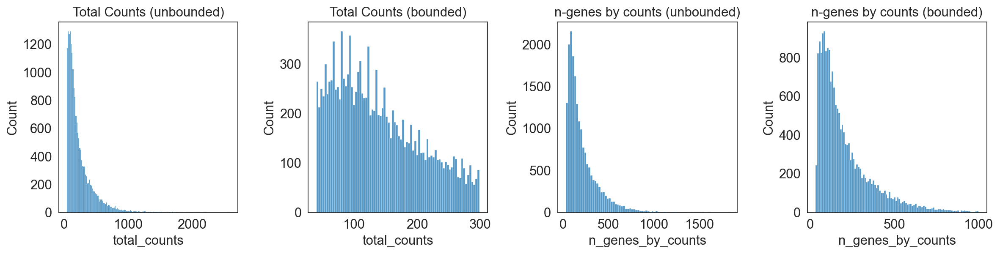

In [13]:
from banksy_utils.plot_utils import plot_qc_hist, plot_cell_positions

# bin options for fomratting histograms
# Here, we set 'auto' for 1st figure, 80 bins for 2nd figure. and so on
hist_bin_options = ['auto', 80, 80, 100]

plot_qc_hist(adata, 
         total_counts_cutoff = 300, # for visualization
         n_genes_high_cutoff = 1000, # for visualization
         n_genes_low_cutoff = 0, # for visualization
         bin_options = hist_bin_options)

In [14]:
from banksy_utils.filter_utils import filter_cells

# Filter cells with each respective filters
adata = filter_cells(adata, 
             min_count=40, 
             max_count=1000, 
             MT_filter=20, 
             gene_filter=10)

Cells before filtering: 18921

Cells after count filter: 18692

cells after MT filter: 18327
Genes after minimum cells per gene filter: 12432


In [15]:
display_adata(adata)

Displaying adata Object and their attributes
Adata attributes and dimensions:


AnnData object with n_obs × n_vars = 18327 × 12432
    obs: 'xcoord', 'ycoord', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    obsm: 'coord_xy'

Matrix sparsity: 3701201 filled elements (0.02) out of 227841264
max: 177.0, min: 1.0

Displaying observations (adata.obs)


,xcoord,ycoord,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,n_counts
s_008um_00565_00641-1,2550.126545,16836.205048,74,4.317488,81.0,4.406719,70.370370,100.000000,100.000000,100.000000,7.0,2.079442,8.641975,81.0
s_008um_00260_00651-1,2124.002393,7938.413376,373,5.924256,423.0,6.049734,23.640662,35.460993,59.101655,100.000000,19.0,2.995732,4.491726,423.0
s_008um_00748_00506-1,6571.014702,22117.561671,123,4.820282,132.0,4.890349,44.696970,82.575758,100.000000,100.000000,12.0,2.564949,9.090909,132.0
s_008um_00604_00550-1,5223.437724,17934.298439,158,5.068904,171.0,5.147494,36.842105,66.081871,100.000000,100.000000,3.0,1.386294,1.754386,171.0
s_008um_00111_00190-1,15518.695155,3382.160731,517,6.249975,596.0,6.391917,20.637584,30.033557,46.812081,97.147651,19.0,2.995732,3.187919,596.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
s_008um_00163_00540-1,5321.640936,5057.201812,219,5.393628,240.0,5.484797,29.583333,50.416667,92.083333,100.000000,9.0,2.302585,3.750000,240.0
s_008um_00358_00538-1,5465.680103,10748.741747,59,4.094345,59.0,4.094345,84.745763,100.000000,100.000000,100.000000,1.0,0.693147,1.694915,59.0
s_008um_00317_00210-1,15024.504337,9405.882478,387,5.961005,421.0,6.045005,19.952494,31.828979,55.581948,100.000000,5.0,1.791759,1.187648,421.0
s_008um_00357_00678-1,1378.612305,10781.786387,191,5.257495,217.0,5.384495,35.023041,58.064516,100.000000,100.000000,20.0,3.044523,9.216590,217.0


Displaying variables (adata.var)


,gene_ids,feature_types,mt,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts,n_cells
Xkr4,ENSMUSG00000051951,Gene Expression,False,259,0.013518,0.013428,98.683742,266.0,5.587249,234
Sox17,ENSMUSG00000025902,Gene Expression,False,36,0.001880,0.001879,99.817045,37.0,3.637586,36
Lypla1,ENSMUSG00000025903,Gene Expression,False,100,0.005133,0.005120,99.491792,101.0,4.624973,93
Tcea1,ENSMUSG00000033813,Gene Expression,False,597,0.031356,0.030875,96.966001,617.0,6.426488,543
Rgs20,ENSMUSG00000002459,Gene Expression,False,235,0.012197,0.012123,98.805712,240.0,5.484797,220
...,...,...,...,...,...,...,...,...,...,...
mt-Nd4,ENSMUSG00000064363,Gene Expression,True,6457,0.435737,0.361678,67.185038,8574.0,9.056606,6024
mt-Nd5,ENSMUSG00000064367,Gene Expression,True,6763,0.469838,0.385152,65.629923,9245.0,9.131947,6323
mt-Nd6,ENSMUSG00000064368,Gene Expression,True,1122,0.060324,0.058575,94.297911,1187.0,7.080027,1050
mt-Cytb,ENSMUSG00000064370,Gene Expression,True,11058,0.969508,0.677784,43.802409,19077.0,9.856291,10389


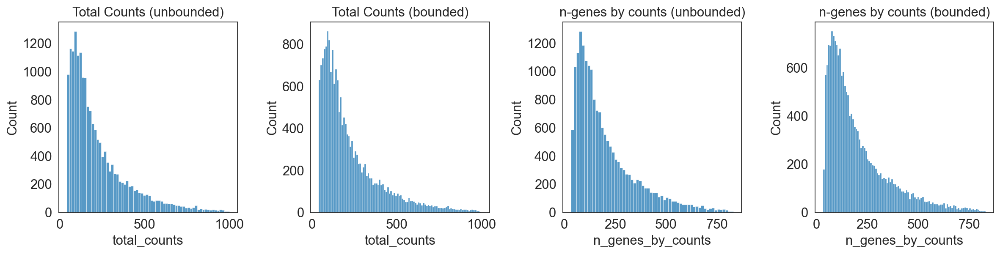

In [16]:
hist_bin_options = ['auto', 100, 60, 100]

plot_qc_hist(adata,
        total_counts_cutoff=2000,
        n_genes_high_cutoff=2000, 
        n_genes_low_cutoff= 0,
        bin_options = hist_bin_options)

{'fig_size': (6, 6), 's': 0.2, 'c1': 'red', 'c2': 'slateblue', 'label1': 'Original cells', 'label2': 'Remaining cells', 'add_circle': False, 'puck_center': (3330, 3180), 'puck_radius': 2550}


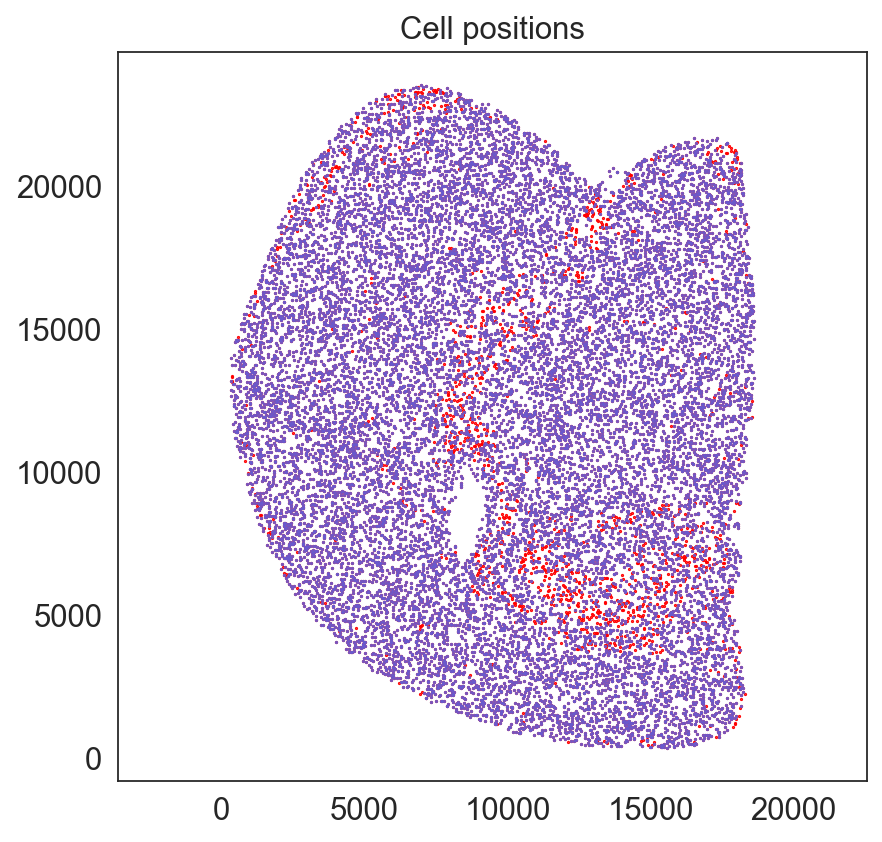

In [17]:
# Visualize cell positions in puck
plot_cell_positions(adata,
            raw_x,
            raw_y,
            coord_keys=coord_keys,
            fig_size = (6,6))

In [18]:
from banksy_utils.filter_utils import normalize_total, filter_hvg, print_max_min

# Normalizes the anndata dataset
adata = normalize_total(adata)

--- Max-Min before normalization -----
Displaying max and min of Dataset
Max: 177.0, Min: 0.0

--- Max-Min after normalization -----
Displaying max and min of Dataset
Max: 44.58986282348633, Min: 0.0


In [19]:
adata, adata_allgenes = filter_hvg(adata,
            n_top_genes = 2000,
            flavor="seurat")

--- Normalized and log-transformed data -----
Displaying max and min of Dataset
Max: 3.819685459136963, Min: 0.0
Displaying dataset after filtering by HVG
View of AnnData object with n_obs × n_vars = 18327 × 2000
    obs: 'xcoord', 'ycoord', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    obsm: 'coord_xy'


In [20]:
display_adata(adata)

Displaying adata Object and their attributes
Adata attributes and dimensions:


View of AnnData object with n_obs × n_vars = 18327 × 2000
    obs: 'xcoord', 'ycoord', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    obsm: 'coord_xy'

Matrix sparsity: 433607 filled elements (0.01) out of 36654000
max: 44.58986282348633, min: 0.1643286645412445

Displaying observations (adata.obs)


,xcoord,ycoord,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,n_counts
s_008um_00565_00641-1,2550.126545,16836.205048,74,4.317488,81.0,4.406719,70.370370,100.000000,100.000000,100.000000,7.0,2.079442,8.641975,81.0
s_008um_00260_00651-1,2124.002393,7938.413376,373,5.924256,423.0,6.049734,23.640662,35.460993,59.101655,100.000000,19.0,2.995732,4.491726,423.0
s_008um_00748_00506-1,6571.014702,22117.561671,123,4.820282,132.0,4.890349,44.696970,82.575758,100.000000,100.000000,12.0,2.564949,9.090909,132.0
s_008um_00604_00550-1,5223.437724,17934.298439,158,5.068904,171.0,5.147494,36.842105,66.081871,100.000000,100.000000,3.0,1.386294,1.754386,171.0
s_008um_00111_00190-1,15518.695155,3382.160731,517,6.249975,596.0,6.391917,20.637584,30.033557,46.812081,97.147651,19.0,2.995732,3.187919,596.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
s_008um_00163_00540-1,5321.640936,5057.201812,219,5.393628,240.0,5.484797,29.583333,50.416667,92.083333,100.000000,9.0,2.302585,3.750000,240.0
s_008um_00358_00538-1,5465.680103,10748.741747,59,4.094345,59.0,4.094345,84.745763,100.000000,100.000000,100.000000,1.0,0.693147,1.694915,59.0
s_008um_00317_00210-1,15024.504337,9405.882478,387,5.961005,421.0,6.045005,19.952494,31.828979,55.581948,100.000000,5.0,1.791759,1.187648,421.0
s_008um_00357_00678-1,1378.612305,10781.786387,191,5.257495,217.0,5.384495,35.023041,58.064516,100.000000,100.000000,20.0,3.044523,9.216590,217.0


Displaying variables (adata.var)


,gene_ids,feature_types,mt,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts,n_cells
St18,ENSMUSG00000033740,Gene Expression,False,38,0.001982,0.001980,99.806881,39.0,3.688879,33
Rrs1,ENSMUSG00000061024,Gene Expression,False,108,0.005641,0.005625,99.451136,111.0,4.718499,104
Adhfe1,ENSMUSG00000025911,Gene Expression,False,99,0.005031,0.005019,99.496875,99.0,4.605170,97
Prex2,ENSMUSG00000048960,Gene Expression,False,212,0.011231,0.011169,98.922600,221.0,5.402678,197
Sulf1,ENSMUSG00000016918,Gene Expression,False,78,0.004116,0.004108,99.603598,81.0,4.406719,73
...,...,...,...,...,...,...,...,...,...,...
mt-Atp8,ENSMUSG00000064356,Gene Expression,True,10422,0.860700,0.620953,47.034609,16936.0,9.737256,9763
mt-Atp6,ENSMUSG00000064357,Gene Expression,True,12756,1.274737,0.821864,35.173045,25083.0,10.129986,11985
mt-Co3,ENSMUSG00000064358,Gene Expression,True,11912,1.118971,0.750931,39.462316,22018.0,9.999661,11185
mt-Nd3,ENSMUSG00000064360,Gene Expression,True,1841,0.101540,0.096709,90.643899,1998.0,7.600402,1709


In [21]:
from banksy.main import median_dist_to_nearest_neighbour

# set params
# ==========
plot_graph_weights = True
k_geom = 15 # only for fixed type
max_m = 1 # azumithal transform up to kth order
nbr_weight_decay = "scaled_gaussian" # can also be "reciprocal", "uniform" or "ranked"

# Find median distance to closest neighbours, the median distance will be `sigma`
nbrs = median_dist_to_nearest_neighbour(adata, key = coord_keys[2])


Median distance to closest cell = 65.2797834092236

---- Ran median_dist_to_nearest_neighbour in 0.10 s ----



Median distance to closest cell = 65.2797834092236

---- Ran median_dist_to_nearest_neighbour in 0.09 s ----

---- Ran generate_spatial_distance_graph in 0.19 s ----
---- Ran row_normalize in 0.07 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 0.91 s ----

----- Plotting Edge Histograms for m = 0 -----

Edge weights (distances between cells): median = 206.56065602999345, mode = 233.53235392843592

---- Ran plot_edge_histogram in 0.08 s ----


Edge weights (weights between cells): median = 0.05773769708227982, mode = 0.03570617605470181

---- Ran plot_edge_histogram in 0.07 s ----
---- Ran generate_spatial_distance_graph in 0.27 s ----
---- Ran theta_from_spatial_graph in 0.39 s ----
---- Ran row_normalize in 0.09 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 1.39 s ----

----- Plotting Edge Histograms for m = 1 -----

Edge weights (distances between cells): median = 293.4532464643252, mode = 204.61826231375477

---- Ran plot_edge_histogram in 0.09 s ----

Edge weigh

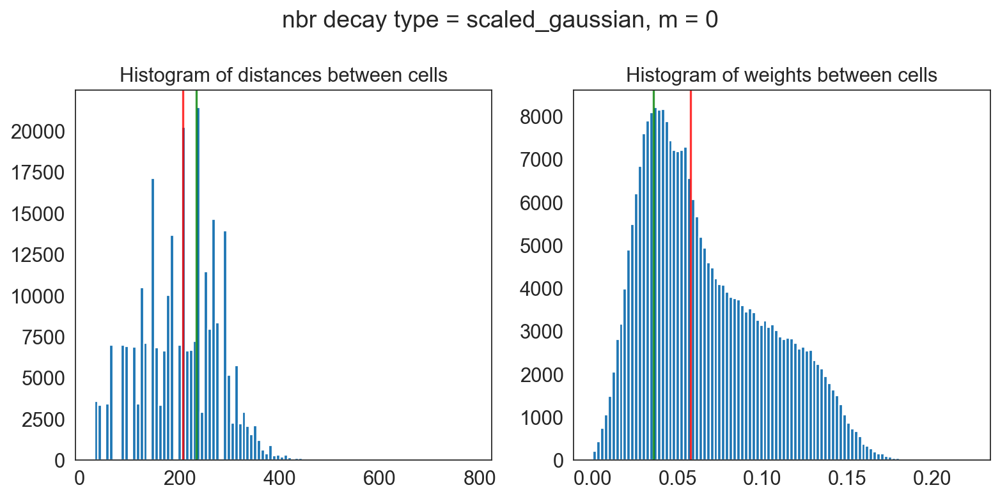

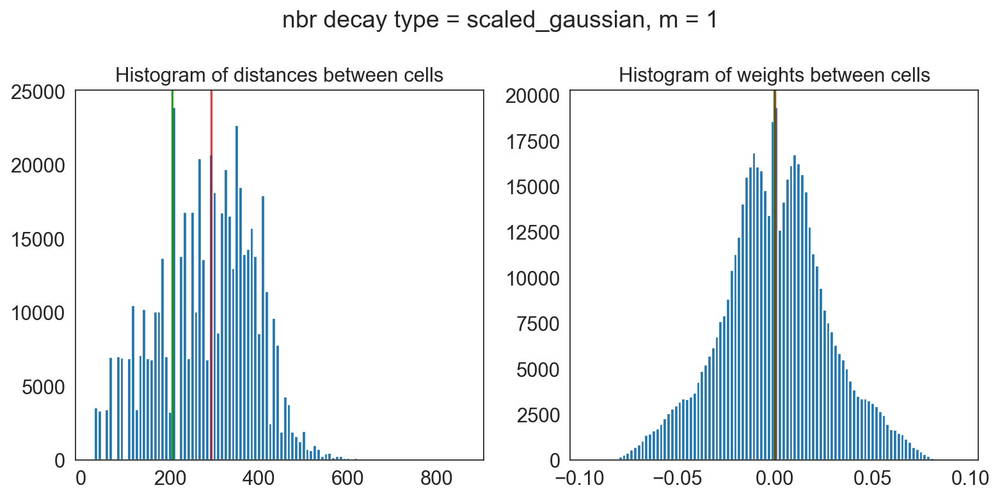

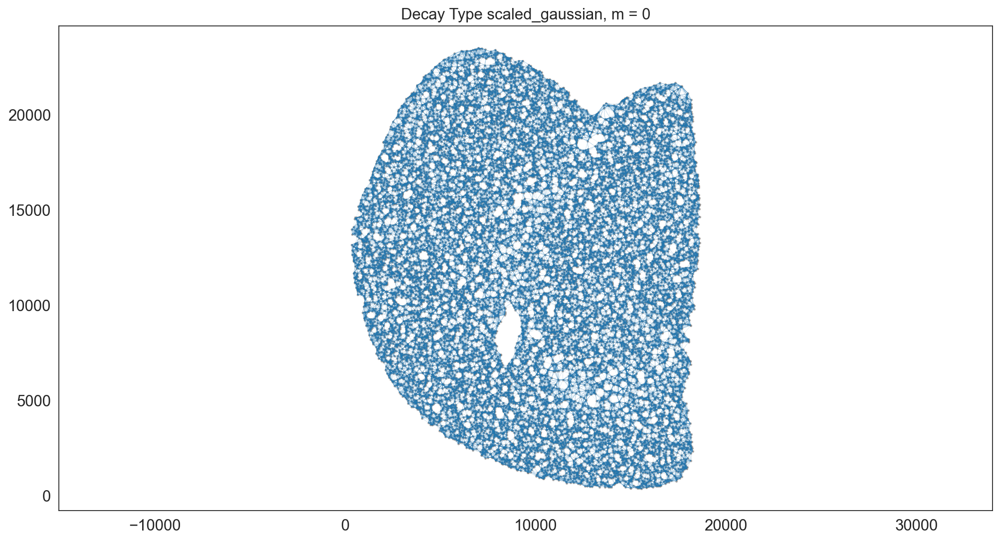

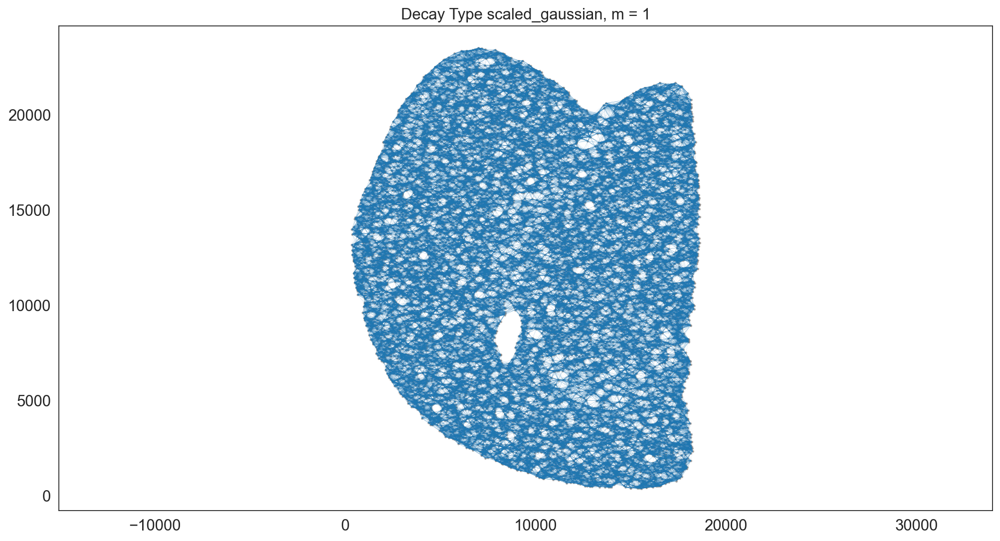

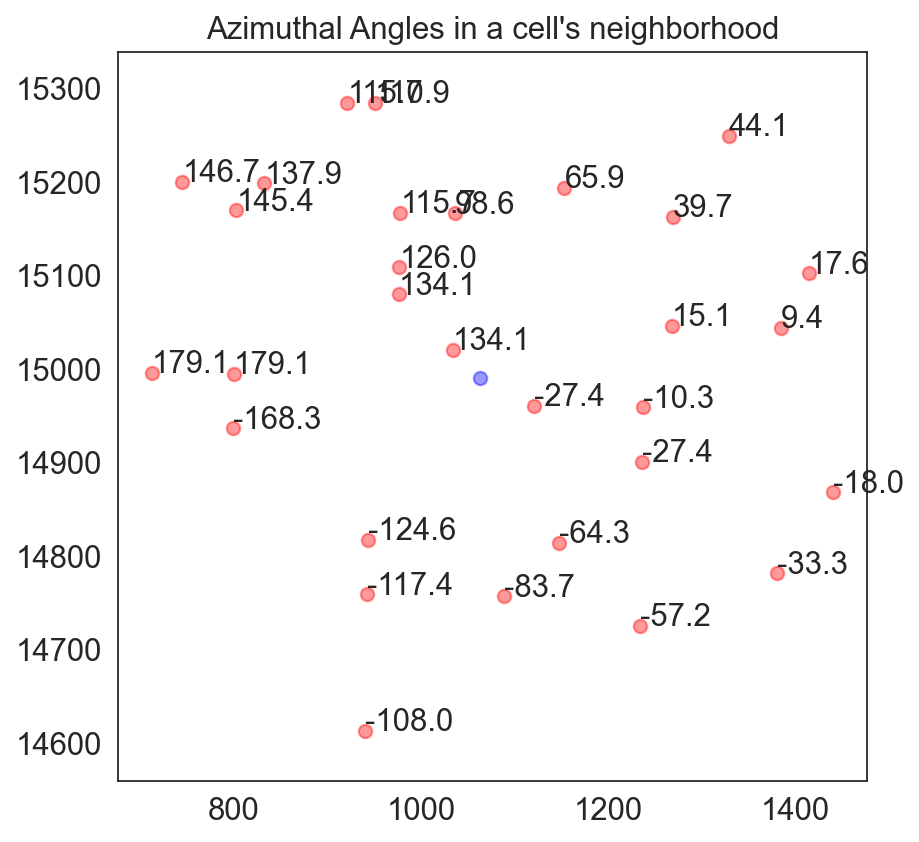

In [22]:
from banksy.initialize_banksy import initialize_banksy

banksy_dict = initialize_banksy(
    adata,
    coord_keys,
    k_geom,
    nbr_weight_decay=nbr_weight_decay,
    max_m=max_m,
    plt_edge_hist=True,
    plt_nbr_weights=True,
    plt_agf_angles=False, # takes long time to plot
    plt_theta=True,
)

In [23]:
from banksy.embed_banksy import generate_banksy_matrix

# The following are the main hyperparameters for BANKSY
resolutions = [0.7] # clustering resolution for UMAP
pca_dims = [20] # Dimensionality in which PCA reduces to
lambda_list = [0.2] # list of lambda parameters

banksy_dict, banksy_matrix = generate_banksy_matrix(adata, banksy_dict, lambda_list, max_m)

Runtime Jun-09-2025-11-48

2000 genes to be analysed:
Gene List:
Index(['St18', 'Rrs1', 'Adhfe1', 'Prex2', 'Sulf1', 'Eya1', 'Paqr8', 'Lman2l',
       'Cnnm3', 'Map4k4',
       ...
       'Gpm6b', 'Egfl6', 'Tlr7', 'mt-Co1', 'mt-Co2', 'mt-Atp8', 'mt-Atp6',
       'mt-Co3', 'mt-Nd3', 'mt-Nd6'],
      dtype='object', length=2000)

Check if X contains only finite (non-NAN) values
Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <18327x18327 sparse matrix of type '<class 'numpy.float64'>'
	with 274905 stored elements in Compressed Sparse Row format>, 1: <18327x18327 sparse matrix of type '<class 'numpy.complex128'>'
	with 549810 stored elements in Compressed Sparse Row format>}}

Nbr matrix | Mean: 0.01 | Std: 0.09
Size of Nbr | Shape: (18327, 2000)
Top 3 entries of Nbr Mat:

[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]

AGF matrix | Mean: 0.01 | Std: 0.03
Size of AGF mat (m = 1) | Shape: (18327, 2000)
Top entries of AGF:
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
Ran 'Create BANKSY Matrix' in 

In [24]:
from banksy.main import concatenate_all

banksy_dict["nonspatial"] = {
    # Here we simply append the nonspatial matrix (adata.X) to obtain the nonspatial clustering results
    0.0: {"adata": concatenate_all([adata.X], 0, adata=adata), }
}

print(banksy_dict['nonspatial'][0.0]['adata'])

Scale factors squared: [1.]
Scale factors: [1.]
AnnData object with n_obs × n_vars = 18327 × 2000
    obs: 'xcoord', 'ycoord', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'is_nbr', 'k'


In [25]:
from banksy_utils.umap_pca import pca_umap

pca_umap(banksy_dict,
         pca_dims = pca_dims,
         add_umap = True,
         plt_remaining_var = False,
         )

Current decay types: ['scaled_gaussian', 'nonspatial']

Reducing dims of dataset in (Index = scaled_gaussian, lambda = 0.2)

Setting the total number of PC = 20
Original shape of matrix: (18327, 6000)
Reduced shape of matrix: (18327, 20)
------------------------------------------------------------
min_value = -95.767948074408, mean = -7.38185938171676e-17, max = 159.04465356103594

Conducting UMAP and adding embeddings to adata.obsm["reduced_pc_20_umap"]
UMAP embedding
------------------------------------------------------------
shape: (18327, 2)


AxisArrays with keys: reduced_pc_20, reduced_pc_20_umap

Reducing dims of dataset in (Index = nonspatial, lambda = 0.0)

Setting the total number of PC = 20
Original shape of matrix: (18327, 2000)
Reduced shape of matrix: (18327, 20)
------------------------------------------------------------
min_value = -114.0701675415039, mean = -1.5361196759045015e-08, max = 206.9737548828125

Conducting UMAP and adding embeddings to adata.obsm["reduced_

In [26]:
from banksy.cluster_methods import run_Leiden_partition

results_df, max_num_labels = run_Leiden_partition(
    banksy_dict,
    resolutions,
    num_nn = 50,
    num_iterations = -1,
    partition_seed = seed,
    match_labels = True,
)

Decay type: scaled_gaussian
Neighbourhood Contribution (Lambda Parameter): 0.2
reduced_pc_20 

reduced_pc_20_umap 

PCA dims to analyse: [20]

Setting up partitioner for (nbr decay = scaled_gaussian), Neighbourhood contribution = 0.2, PCA dimensions = 20)

Nearest-neighbour weighted graph (dtype: float64, shape: (18327, 18327)) has 916350 nonzero entries.
---- Ran find_nn in 10.40 s ----


Nearest-neighbour connectivity graph (dtype: int16, shape: (18327, 18327)) has 916350 nonzero entries.

(after computing shared NN)
Allowing nearest neighbours only reduced the number of shared NN from 23336525 to 910311.

Shared nearest-neighbour (connections only) graph (dtype: int16, shape: (18327, 18327)) has 801757 nonzero entries.

Shared nearest-neighbour (number of shared neighbours as weights) graph (dtype: int16, shape: (18327, 18327)) has 801757 nonzero entries.

sNN graph data:
[28 33 27 ... 11  5  7]

---- Ran shared_nn in 1.20 s ----


-- Multiplying sNN connectivity by weights --


sha

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,relabeled
nonspatial_pc20_nc0.00_r0.70,nonspatial,0.0,20,0.7,16,"Label object:\nNumber of labels: 16, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 16, number of..."
scaled_gaussian_pc20_nc0.20_r0.70,scaled_gaussian,0.2,20,0.7,14,"Label object:\nNumber of labels: 14, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 14, number of..."


Saving figure at data\visium_hd_processed\tmp_png\slideseq_mousecerebellum_nonspatial_pc20_nc0.00_r0.70_spatialmap.png
number of labels: 16
---- Ran plot_2d_embeddings in 0.00 s ----

number of labels: 16
---- Ran plot_2d_embeddings in 0.00 s ----

number of labels: 16
---- Ran plot_2d_embeddings in 0.00 s ----

---- Ran row_normalize in 0.00 s ----


matrix multiplying labels x weights x labels-transpose ((16, 18327) x (18327, 18327) x (18327, 16))

Saving figure at data\visium_hd_processed\tmp_png\slideseq_mousecerebellum_scaled_gaussian_pc20_nc0.20_r0.70_spatialmap.png
number of labels: 14
---- Ran plot_2d_embeddings in 0.01 s ----

number of labels: 14
---- Ran plot_2d_embeddings in 0.00 s ----

number of labels: 14
---- Ran plot_2d_embeddings in 0.00 s ----

---- Ran row_normalize in 0.00 s ----


matrix multiplying labels x weights x labels-transpose ((14, 18327) x (18327, 18327) x (18327, 14))


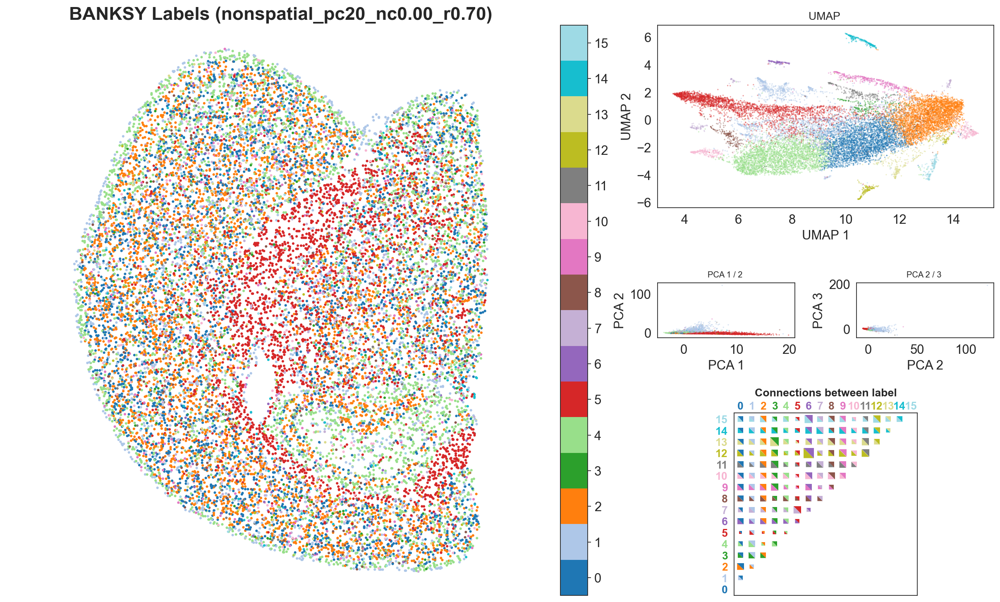

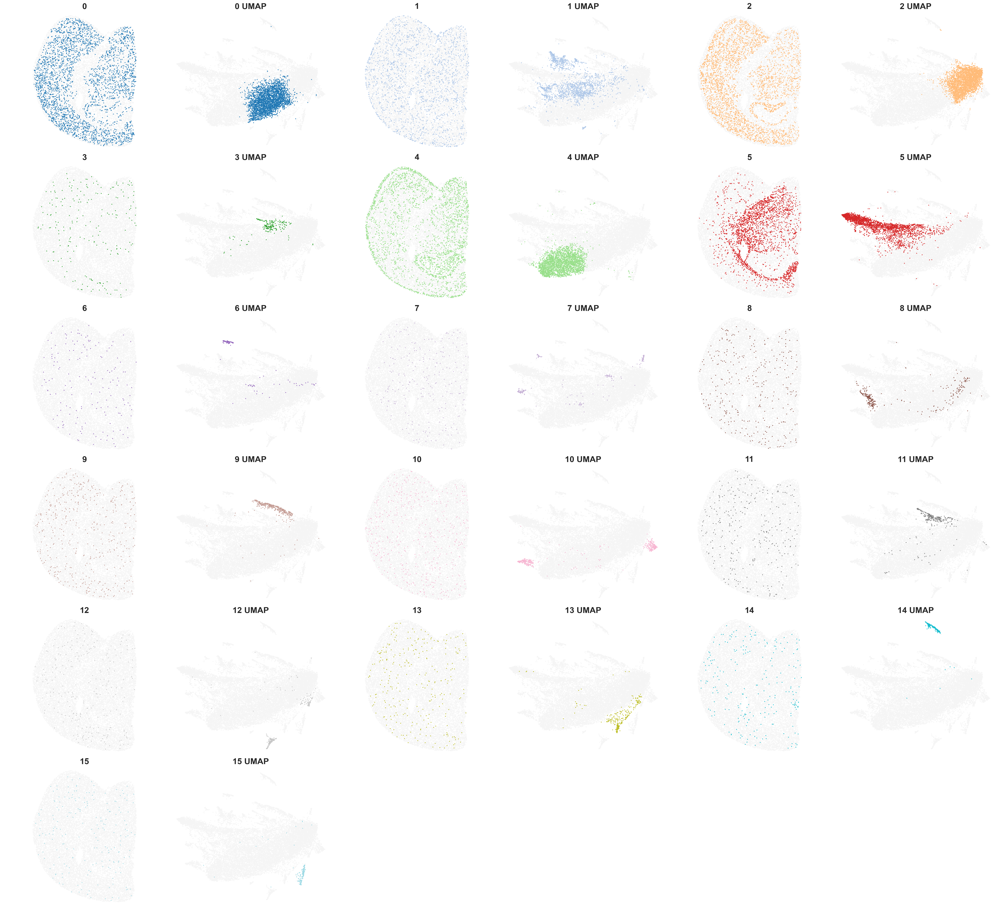

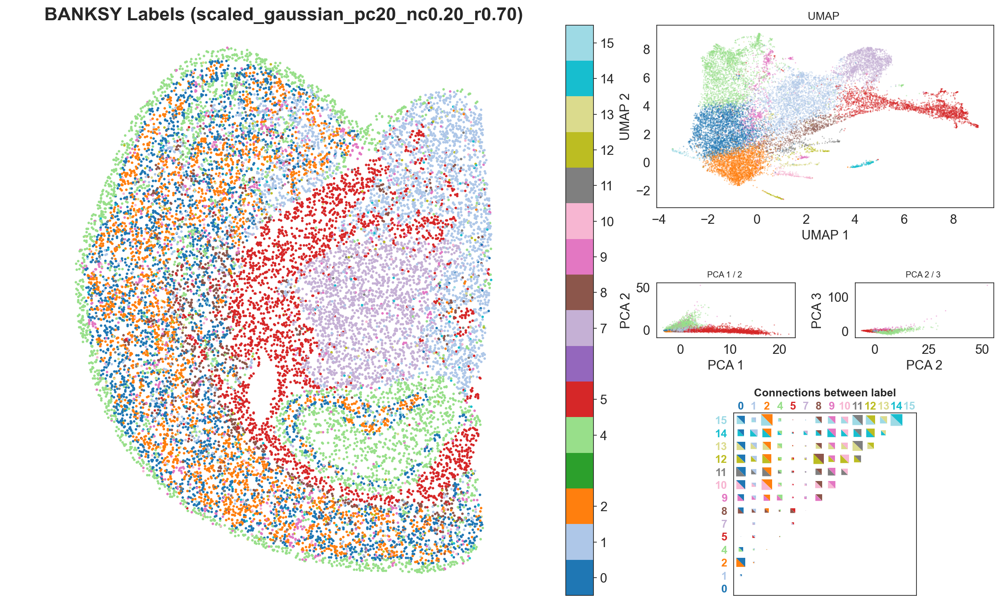

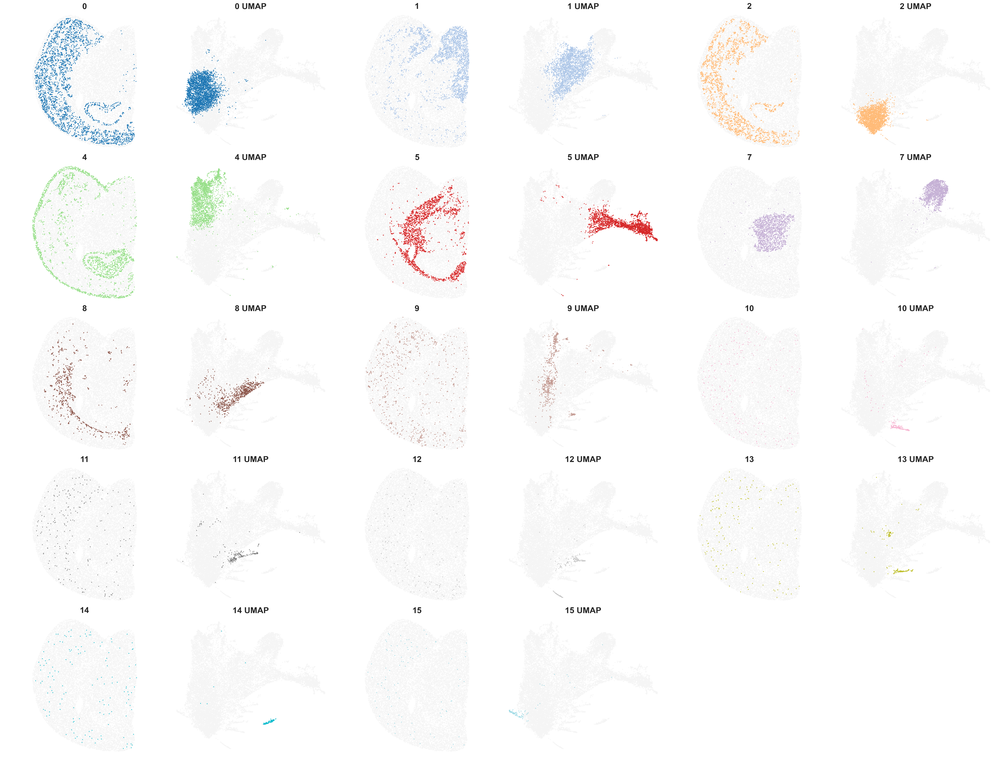

In [27]:
from banksy.plot_banksy import plot_results

c_map =  'tab20' # specify color map
weights_graph =  banksy_dict['scaled_gaussian']['weights'][0]

plot_results(
    results_df,
    weights_graph,
    c_map,
    match_labels = True,
    coord_keys = coord_keys,
    max_num_labels  =  max_num_labels, 
    save_path = os.path.join(file_path, 'tmp_png'),
    save_fig = True, # save the spatial map of all clusters
    save_seperate_fig = True, # save the figure of all clusters plotted seperately
)

In [28]:
from banksy_utils.cluster_utils import pad_clusters, create_spatial_nonspatial_adata,  refine_cell_types

# Here we manually assign clusters to their identity using a dictionary
cluster2annotation_spatial = {
    "0": "Cortical Outer Layers (I-III)",    # 大脑皮层外层 
    "2": "Cortical Deep Layers (IV-VI)",     # 大脑皮层深层
    "4": "Striatum (Caudate-Putamen)",       # 纹状体
    "5": "Ventricular System/Choroid Plexus", # 脑室系统/脉络丛
    "7": "Thalamus"                           # 丘脑
    #此处有问题，我不知每个簇对应什么标签，此处每个簇对应的细胞为我用claude分析的结果
}

pad_clusters(cluster2annotation_spatial, list(range(max_num_labels)))

In [35]:
# Here, most clusters match so copy labels from spatial
# cluster2annotation_nonspatial = cluster2annotation_spatial.copy()
# cluster2annotation_nonspatial["4"] = "Purkinje/Bergmann"
# cluster2annotation_nonspatial["8"] = "other"
# cluster2annotation_nonspatial["11"] = "Choroid Plexus"
# cluster2annotation_nonspatial["15"] = "other"

cluster2annotation_nonspatial = {
    "0": "Cortical Outer Layers (I-III)",    # 大脑皮层外层 
    "2": "Cortical Deep Layers (IV-VI)",     # 大脑皮层深层
    "4": "Striatum (Caudate-Putamen)",       # 纹状体
    "5": "Ventricular System/Choroid Plexus", # 脑室系统/脉络丛
    "7": "Thalamus"                           # 丘脑
}

print(cluster2annotation_spatial,"\n", cluster2annotation_nonspatial)

# save annotations in two different anndata objects (adata_spatial and adata_nonspatial)

adata_spatial, adata_nonspatial = create_spatial_nonspatial_adata(results_df,
                                    pca_dims,
                                    lambda_list, 
                                    resolutions,
                                    cluster2annotation_spatial,
                                    cluster2annotation_nonspatial)

{'0': 'Cortical Outer Layers (I-III)', '2': 'Cortical Deep Layers (IV-VI)', '4': 'Striatum (Caudate-Putamen)', '5': 'Ventricular System/Choroid Plexus', '7': 'Thalamus', '1': 'other', '3': 'other', '6': 'other', '8': 'other', '9': 'other', '10': 'other', '11': 'other', '12': 'other', '13': 'other', '14': 'other', '15': 'other'} 
 {'0': 'Cortical Outer Layers (I-III)', '2': 'Cortical Deep Layers (IV-VI)', '4': 'Striatum (Caudate-Putamen)', '5': 'Ventricular System/Choroid Plexus', '7': 'Thalamus'}
scaled_gaussian_pc20_nc0.20_r0.70
nonspatial_pc20_nc0.00_r0.70


In [36]:
from banksy_utils.plot_utils import plot_DE_genes, plot_DE_genes_refined, plot_connection_grid, plot_clusters
adata_spatial_filtered, adata_nonspatial_filtered = refine_cell_types(adata_spatial, 
                                                                      adata_nonspatial,
                                                                      cluster2annotation_spatial
                                                                      )

In [37]:

adata_self = plot_DE_genes_refined(adata_spatial_filtered, plot_heatmap = False, save_fig = False)

         Falling back to preprocessing with `sc.pp.pca` and default params.


All refined cell types: Index(['Cortical Deep Layers (IV-VI)', 'Cortical Outer Layers (I-III)',
       'Striatum (Caudate-Putamen)', 'Thalamus',
       'Ventricular System/Choroid Plexus', 'other'],
      dtype='object')
[1. 1. 1. ... 1. 1. 1.] (18327, 18327)
[1. 1. 1. ... 1. 1. 1.] (18327, 18327)


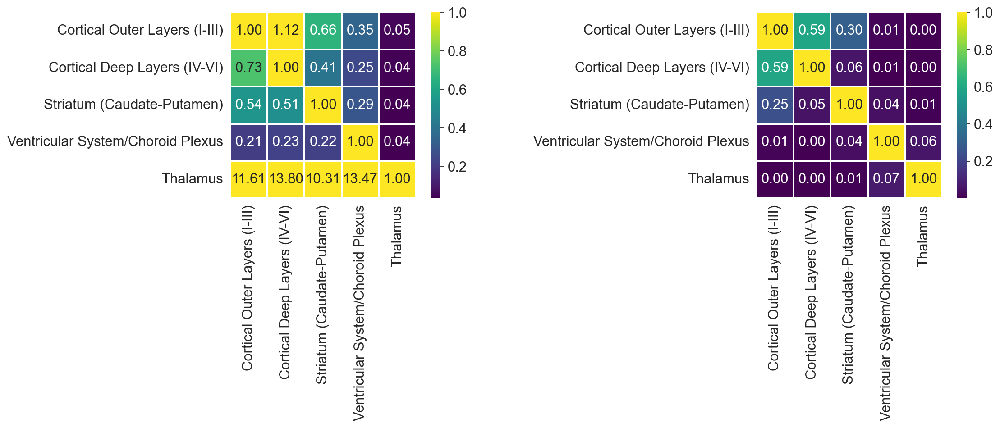

In [38]:
cell_types = ["Cortical Outer Layers (I-III)", 
              "Cortical Deep Layers (IV-VI)", 
              "Striatum (Caudate-Putamen)",
              "Ventricular System/Choroid Plexus",
              "Thalamus"]

plot_connection_grid(
    banksy_dict["scaled_gaussian"]["weights"][0].copy(),
    adata_nonspatial,
    adata_spatial,
    cell_types= cell_types,
    save_fig=False
)

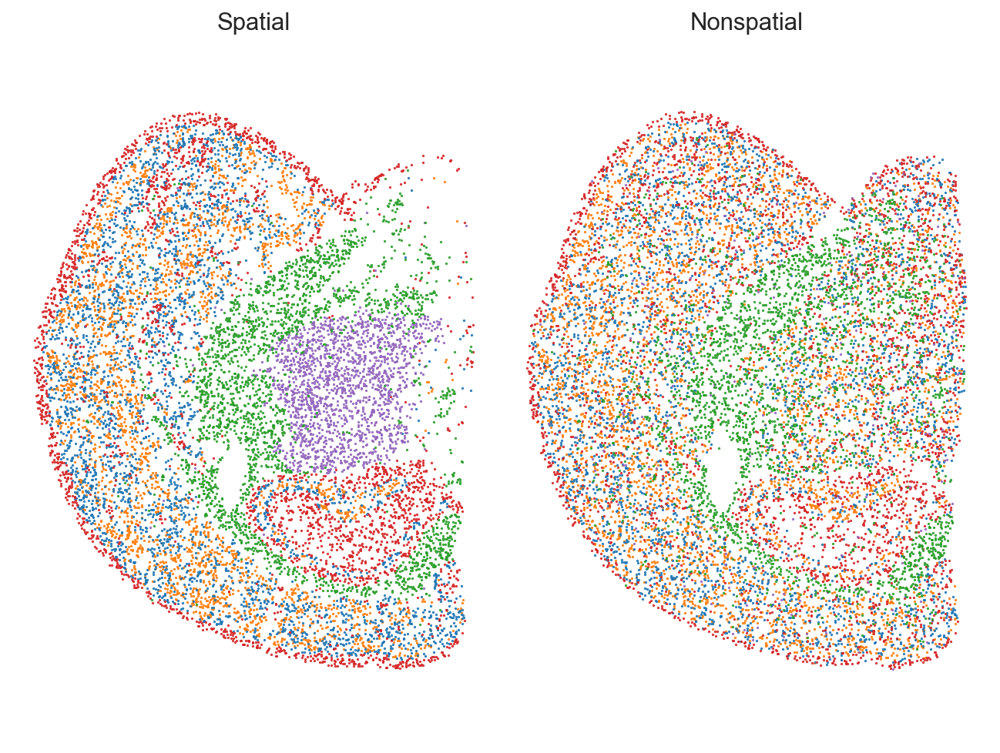

In [39]:
# choose colours for each cluster
colors_dict = {
    "Cortical Outer Layers (I-III)": "tab:blue",
    "Cortical Deep Layers (IV-VI)": "tab:orange",
    "Striatum (Caudate-Putamen)": "tab:red",
    "Ventricular System/Choroid Plexus": "tab:green",
    "Thalamus":  "tab:purple",
}

plot_clusters(
    adata_spatial,
    adata_nonspatial,
    colors_dict,
)

In [40]:
# display(adata_allgenes)
print_max_min(adata_allgenes)

# z-score the unfiltered gene-cell matrix
# ---------------------------------------
sc.pp.scale(adata_allgenes)
# display(adata_allgenes)
print_max_min(adata_allgenes)

Displaying max and min of Dataset
Max: 44.58986282348633, Min: 0.0
Displaying max and min of Dataset
Max: 126.32328033447266, Min: -0.8795092105865479


In [41]:
# Metagene Dataframe
from banksy_utils.cluster_utils import create_metagene_df

metagene_df = create_metagene_df(adata_allgenes, coord_keys)
metagene_df.head()

Generating Metagene data...

14 DE markers for GranularNeuron_Gabra6
54 DE markers for PurkinjeNeuron_Pcp2
69 DE markers for Interneurons_Pvalb
8 scRNA-seq DE genes in Interneurons_Pvalb absent/filtered from slideseq dataset
22 DE markers for Interneurons_and_Other_Nnat
29 DE markers for Microglia_Macrophage_C1qb
4 scRNA-seq DE genes in Microglia_Macrophage_C1qb absent/filtered from slideseq dataset
79 DE markers for Oligodendrocyte_Polydendrocyte_Tfr_Tnr
143 DE markers for BergmannGlia_Gpr37l1
10 DE markers for Astrocyte_Gja1
28 DE markers for Choroid_Plexus_Ttr
187 DE markers for Endothelial_Flt1
31 scRNA-seq DE genes in Endothelial_Flt1 absent/filtered from slideseq dataset
100 DE markers for Fibroblast-Like_Dcn


,xcoord,ycoord,GranularNeuron_Gabra6,PurkinjeNeuron_Pcp2,Interneurons_Pvalb,Interneurons_and_Other_Nnat,Microglia_Macrophage_C1qb,Oligodendrocyte_Polydendrocyte_Tfr_Tnr,BergmannGlia_Gpr37l1,Astrocyte_Gja1,Choroid_Plexus_Ttr,Endothelial_Flt1,Fibroblast-Like_Dcn
s_008um_00565_00641-1,2550.126545,16836.205048,-0.079633,0.013730,0.191999,-0.134027,-0.052331,-0.074824,0.020704,-0.078265,-0.037452,0.113035,0.148602
s_008um_00260_00651-1,2124.002393,7938.413376,0.180357,0.019125,-0.020621,-0.083035,-0.052331,-0.036626,-0.069800,-0.078265,-0.037452,-0.049529,-0.015542
s_008um_00748_00506-1,6571.014702,22117.561671,0.651362,0.088655,-0.090892,0.290223,-0.052331,-0.074824,0.083209,-0.078265,-0.037452,-0.020589,-0.047958
s_008um_00604_00550-1,5223.437724,17934.298439,-0.079633,-0.039525,-0.090892,-0.043011,-0.052331,-0.048770,0.010517,-0.078265,-0.037452,0.124461,-0.047958
s_008um_00111_00190-1,15518.695155,3382.160731,0.139617,-0.001992,0.092106,-0.042850,-0.052331,-0.046643,0.071935,0.000174,-0.037452,0.042772,-0.047958
